In [1]:
import torch
from PIL import Image
import os
import numpy as np
from tqdm import tqdm
import re

In [2]:
root = '../input/polarbears/arctic_with_bears'
image_folder = '../input/polarbears/arctic_with_bears/bears'
masks_folder = '../input/polarbears/arctic_with_bears/masks'

images = [Image.open(os.path.join(image_folder,  file)).convert("RGBA") for file in sorted(os.listdir(image_folder))]
masks = [Image.open(os.path.join(masks_folder,  file)).convert("RGBA") for file in sorted(os.listdir(masks_folder))]

In [3]:
!mkdir only_bears

In [4]:
bears = []
for image, mask, file in tqdm(zip(images, masks, sorted(os.listdir(image_folder)))):
    bear_arr = []
    bear = image.copy()
    for image_px, mask_px in zip(image.getdata(), mask.getdata()):
        if mask_px == (0, 0, 0, 255):
            bear_arr.append((255, 255, 255, 0))
        else:
            bear_arr.append(image_px)
    bear.putdata(bear_arr)
    bears.append(bear)
    bear.save("./only_bears/{}".format(re.sub('\.\w+$', '.png', file)))

35it [08:23, 14.40s/it]


In [5]:
!mkdir new_images_with_bears

In [6]:
!mkdir new_images_with_bear_masks

In [7]:
masks_files = sorted(os.listdir(masks_folder))

In [39]:
bears_files = sorted(os.listdir(image_folder))

In [8]:
no_bears_files = sorted(os.listdir('../input/polarbears/arctic_no_bears'))

In [30]:
bg_path = '../input/polarbears/arctic_no_bears'
for i, bg_file in enumerate(no_bears_files):
    bear = bears[i % len(bears)]
    bg_img = Image.open(os.path.join(bg_path, bg_file)).crop((0, 0, *bear.size))
    bear_mask = Image.open(os.path.join(masks_folder, masks_files[i % len(bears)])).convert('RGBA')
    bg_mask.paste(bear_mask)
    bg_img.paste(bg_img, bear)
    bg_img.save(f"./new_images_with_bears/{bg_file}")
    bg_mask.save(f"./new_images_with_bear_masks/{bg_file}")

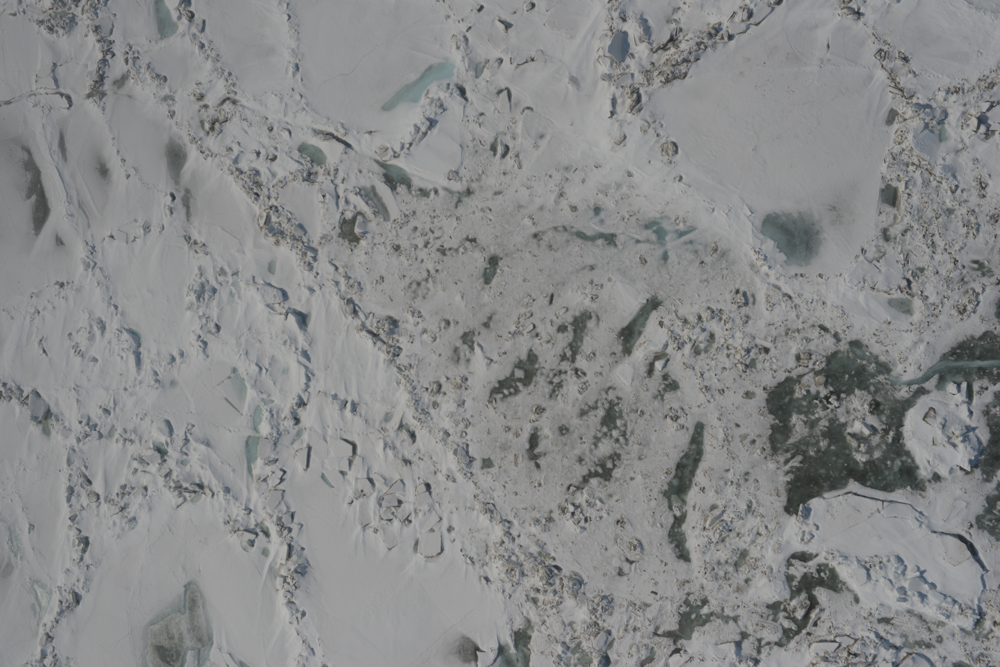

In [31]:
bg_img

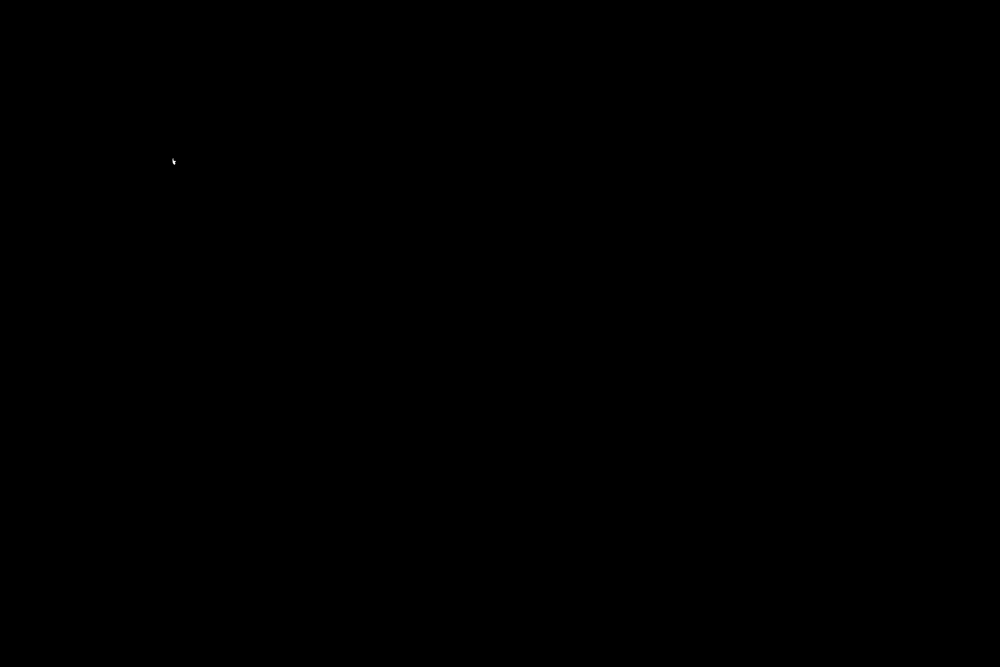

In [32]:
bg_mask

In [70]:
img_size = 640
for idx, mask_file in enumerate(tqdm(masks_files)):
    mask_img = Image.open(os.path.join(masks_folder, mask_file))
    bear_img = Image.open(os.path.join(image_folder, bears_files[idx]))
    x_bordercount = mask_img.size[0] // img_size
    y_bordercount = mask_img.size[1] // img_size
    k = 0
    for i in range(x_bordercount):
        for j in range(y_bordercount):
            left = i * img_size
            top = j * img_size
            right = mask_img.size[0] if i == x_bordercount - 1 else (i + 1) * img_size
            bottom = mask_img.size[1] if j == y_bordercount - 1 else (j + 1) * img_size
            coords = (left, top, right, bottom)
            frame_mask = mask_img.crop(coords)
            if (np.array(frame_mask) != 0).sum():
                frame_bear = bear_img.crop((left, top, right, bottom))
                frame_bear.save(f"./640px/bears/{mask_file}")
                frame_mask.save(f"./640px/masks/{mask_file}")
                print('eeee')

  3%|▎         | 1/35 [00:00<00:23,  1.42it/s]

eeee
eeee


  6%|▌         | 2/35 [00:01<00:26,  1.25it/s]

eeee


  9%|▊         | 3/35 [00:02<00:25,  1.28it/s]

eeee


 11%|█▏        | 4/35 [00:04<00:35,  1.14s/it]

eeee


 14%|█▍        | 5/35 [00:04<00:26,  1.13it/s]

eeee


 17%|█▋        | 6/35 [00:06<00:33,  1.16s/it]

eeee
eeee
eeee


 23%|██▎       | 8/35 [00:09<00:34,  1.29s/it]

eeee


 26%|██▌       | 9/35 [00:09<00:28,  1.09s/it]

eeee


 29%|██▊       | 10/35 [00:11<00:29,  1.18s/it]

eeee


 31%|███▏      | 11/35 [00:11<00:24,  1.03s/it]

eeee


 34%|███▍      | 12/35 [00:13<00:26,  1.16s/it]

eeee


 37%|███▋      | 13/35 [00:14<00:23,  1.05s/it]

eeee


 40%|████      | 14/35 [00:14<00:19,  1.08it/s]

eeee


 43%|████▎     | 15/35 [00:15<00:16,  1.18it/s]

eeee


 46%|████▌     | 16/35 [00:16<00:15,  1.25it/s]

eeee


 49%|████▊     | 17/35 [00:17<00:19,  1.07s/it]

eeee


 51%|█████▏    | 18/35 [00:18<00:16,  1.05it/s]

eeee


 54%|█████▍    | 19/35 [00:19<00:13,  1.16it/s]

eeee
eeee


 57%|█████▋    | 20/35 [00:20<00:16,  1.10s/it]

eeee


 60%|██████    | 21/35 [00:21<00:14,  1.02s/it]

eeee


 63%|██████▎   | 22/35 [00:22<00:11,  1.10it/s]

eeee


 66%|██████▌   | 23/35 [00:23<00:12,  1.05s/it]

eeee


 69%|██████▊   | 24/35 [00:24<00:10,  1.07it/s]

eeee


 71%|███████▏  | 25/35 [00:25<00:08,  1.18it/s]

eeee
eeee


 77%|███████▋  | 27/35 [00:27<00:08,  1.06s/it]

eeee


 80%|████████  | 28/35 [00:29<00:09,  1.33s/it]

eeee


 83%|████████▎ | 29/35 [00:31<00:08,  1.41s/it]

eeee


 86%|████████▌ | 30/35 [00:31<00:05,  1.18s/it]

eeee


 89%|████████▊ | 31/35 [00:33<00:05,  1.28s/it]

eeee


 91%|█████████▏| 32/35 [00:34<00:03,  1.33s/it]

eeee
eeee


 97%|█████████▋| 34/35 [00:38<00:01,  1.52s/it]

eeee


100%|██████████| 35/35 [00:39<00:00,  1.12s/it]

eeee


In [34]:
frame_bear

(7360, 4912)

In [35]:
!mkdir 640px

In [36]:
!mkdir 640px/bears

In [37]:
!mkdir 640px/masks